In [2]:
%matplotlib inline
import seaborn
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display
plt.rcParams['figure.figsize'] = (13, 5)

[&larr; Back to Index](index.html)

# Tempo Estimation

Tempo ([Wikipedia](https://en.wikipedia.org/wiki/Tempo)) refers to the speed of a musical piece. More precisely, tempo refers to the rate of the musical beat and is given by the reciprocal of the beat period. Tempo is often defined in units of beats per minute (BPM).

In classical music, common tempo markings include grave, largo, lento, adagio, andante, moderato, allegro, vivace, and presto. See [Basic tempo markings](https://en.wikipedia.org/wiki/Tempo#Basic_tempo_markings) for more.

## Tempogram

Tempo can vary locally within a piece. Therefore, we introduce the **tempogram** (FMP, p. 317) as a feature matrix which indicates the prevalence of certain tempi at each moment in time.

### Fourier Tempogram

The **Fourier Tempogram** (FMP, p. 319) is basically the magnitude spectrogram of the novelty function.

Load an audio file:

In [39]:
x, sr = librosa.load('audio/李榮浩 - 李白 (官方版MV).mp3')
ipd.Audio(x, rate=sr)

The tempo of this excerpt is about 58/116 BPM.

Compute the onset envelope, i.e. novelty function:

In [27]:
hop_length = 200 # samples per frame
onset_env = librosa.onset.onset_strength(x, sr=sr, hop_length=hop_length, n_fft=2048)

Plot the onset envelope:

In [28]:
frames = range(len(onset_env))
t = librosa.frames_to_time(frames, sr=sr, hop_length=hop_length)

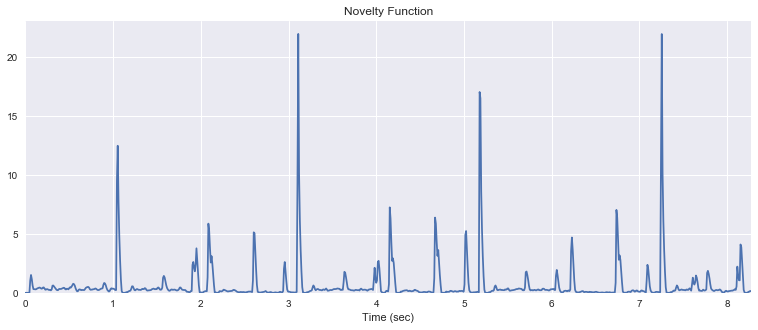

In [29]:
plt.plot(t, onset_env)
plt.xlim(0, t.max())
plt.ylim(0)
plt.xlabel('Time (sec)')
plt.title('Novelty Function')

Compute the short-time Fourier transform (STFT) of the novelty function. Since the novelty function is computed in frame increments, the hop length of this STFT should be pretty small:

In [30]:
S = librosa.stft(onset_env, hop_length=1, n_fft=512)
fourier_tempogram = numpy.absolute(S)

Plot the Fourier tempogram:

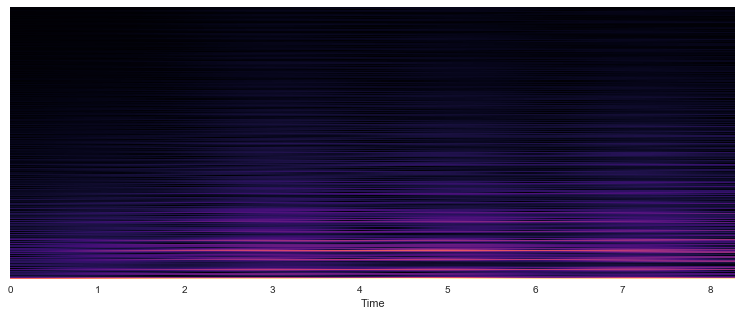

In [31]:
librosa.display.specshow(fourier_tempogram, sr=sr, hop_length=hop_length, x_axis='time')

### Autocorrelation Tempogram

Consider a segment from the above novelty function:

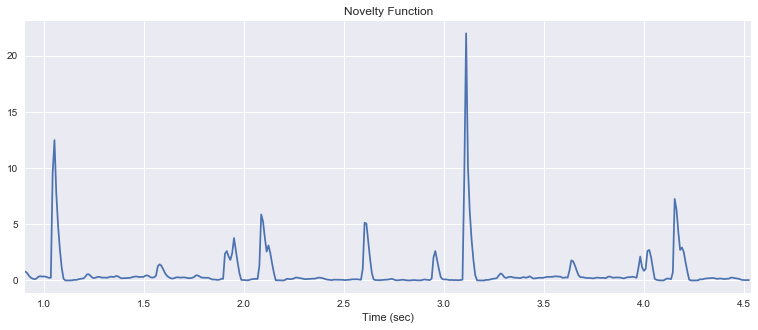

In [32]:
n0 = 100
n1 = 500
plt.plot(t[n0:n1], onset_env[n0:n1])
plt.xlim(t[n0], t[n1])
plt.xlabel('Time (sec)')
plt.title('Novelty Function')

Plot the autocorrelation of this segment:

In [33]:
tmp = numpy.log1p(onset_env[n0:n1])
r = librosa.autocorrelate(tmp)

(0, 147.32610396635053)

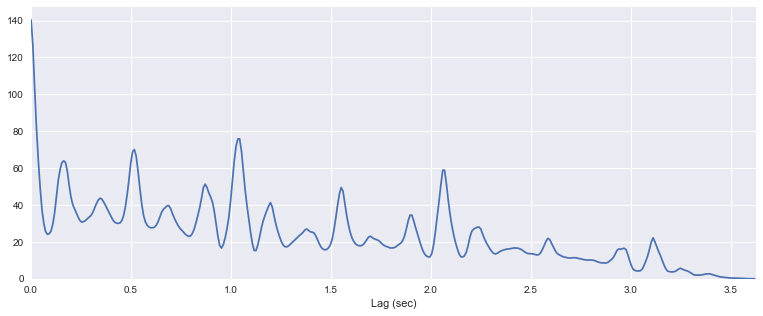

In [34]:
plt.plot(t[:n1-n0], r)
plt.xlim(t[0], t[n1-n0])
plt.xlabel('Lag (sec)')
plt.ylim(0)

Wherever the autocorrelation is high is a good candidate of the beat period.

/Users/kcfdaniel/anaconda/lib/python2.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in divide
  """Entry point for launching an IPython kernel.


(0, 132.57569384938009)

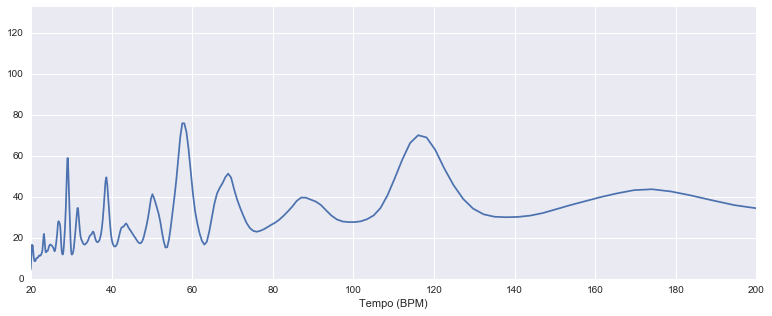

In [35]:
plt.plot(60/t[:n1-n0], r)
plt.xlim(20, 200)
plt.xlabel('Tempo (BPM)')
plt.ylim(0)

We will apply this principle of autocorrelation to estimate the tempo at every segment in the novelty function.

[`librosa.feature.tempogram`](https://librosa.github.io/librosa/generated/librosa.feature.tempogram.html#librosa.feature.tempogram) implements an **autocorrelation tempogram**, a short-time autocorrelation of the (spectral) novelty function.


For more information:
-  [Grosche, Peter, Meinard Müller, and Frank Kurth. “Cyclic tempogram - A mid-level tempo representation for music signals.” ICASSP, 2010.](http://resources.mpi-inf.mpg.de/MIR/tempogramtoolbox/2010_GroscheMuellerKurth_TempogramCyclic_ICASSP.pdf)

Compute a tempogram:

In [36]:
tempogram = librosa.feature.tempogram(onset_envelope=onset_env, sr=sr, hop_length=hop_length, win_length=400)

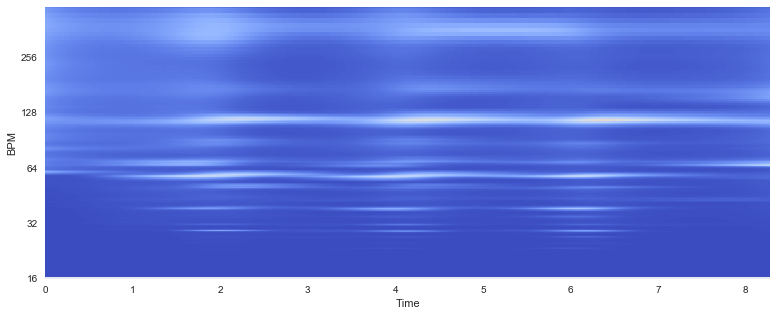

In [37]:
librosa.display.specshow(tempogram, sr=sr, hop_length=hop_length, x_axis='time', y_axis='tempo')

## Estimating Global Tempo

We will use [`librosa.beat.tempo`](https://librosa.github.io/librosa/generated/librosa.beat.tempo.html#librosa.beat.tempo) to estimate the global tempo in an audio file.

Estimate the tempo:

In [40]:
tempo = librosa.beat.tempo(x, sr=sr)
print tempo

[ 117.45383523]


In [25]:
dtempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr, aggregate=None)
for t in dtempo:
    print(t)

61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
61.5234375
129.19921875
129.19921875
129.19921875
129.19921875
12

117.453835227
117.453835227
117.453835227
117.453835227
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.199218

64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375

123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
12

117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
1

64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375

103.359375
103.359375
103.359375
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.1992

117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
117.453835227
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.046875
123.0

107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
107.666015625
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.99

129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875
129.19921875

135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.99

135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375
64.599609375

135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.999177632
135.99

Visualize the tempo estimate on top of the input signal:

In [18]:
T = len(x)/float(sr)
seconds_per_beat = 60.0/tempo[0]
beat_times = numpy.arange(0, T, seconds_per_beat)

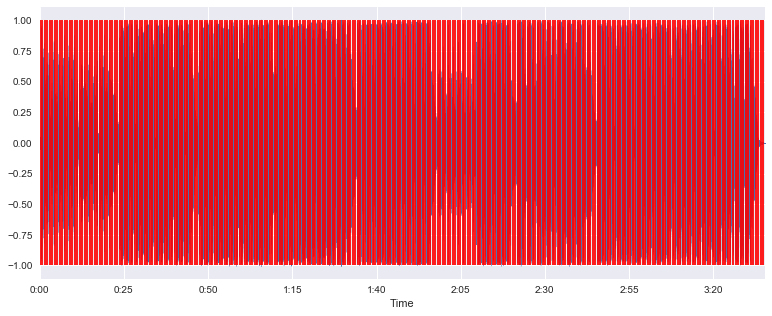

In [19]:
librosa.display.waveplot(x)
plt.vlines(beat_times, -1, 1, color='r')

Listen to the input signal with a click track using the tempo estimate:

In [20]:
clicks = librosa.clicks(beat_times, sr, length=len(x))
ipd.Audio(x + clicks, rate=sr)

[&larr; Back to Index](index.html)